In [1]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
from torch.autograd import Variable, grad
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pickle
import pandas as pd

# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [12]:
##########################################
# Load params
##########################################

# Root directory for dataset
dataroot = "data/pokemon/single_augmented/"
model_dump_path = "condition_model_checkpoints/"
#model_dump_path = "new_model_checkpoints/"
gen_img_path= "c_gen_images/"

# Number of workers for dataloader
num_workers = 2

real_label = 1.0
fake_label = 0.0

# Batch size during training
batch_size = 64

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 128

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
max_epoch = 50

# Learning rate for optimizers
learning_rate = 0.0002

# Beta1 hyperparam for Adam optimizers
beta_1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

#number of iterations to print a message
verbose_T = 500

#when to reduce learning rate
lr_update_cycle = 50000

lambda_adv = 34.0
lambda_gp = 0.5

In [3]:
# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available()) else "cpu")

# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))

class_to_idx = dataset.class_to_idx
del dataset

In [4]:
poke = pd.read_csv("data/pokemon/pokemon.csv")
poke.Legend = poke.Legend.astype('int64')
poke = poke[['#','Name','Type1','Type2', 'Generation', 'Legend']]

poke.head()

,#,Name,Type1,Type2,Generation,Legend
0,1,Bulbasaur,Grass,Poison,1,0
1,2,Ivysaur,Grass,Poison,1,0
2,3,Venusaur,Grass,Poison,1,0
3,3,Mega Venusaur,Grass,Poison,6,0
4,4,Charmander,Fire,None,1,0


In [5]:
#set up types
types = set(poke.Type1.unique()).union(set(poke.Type2.unique()))
types = types - set('None')
types = list(types)
type_map = dict()
for i, j in enumerate(types):
    type_map[j] = i
    
#populate dataset class_index to feature dictionary
idx_to_feat = {}
for class_name, class_index in class_to_idx.items():
    names = class_name.split("_")
    index = names[0]
    if len(names) > 1:
        words = names[1].split("-")
        pat = ""
        for w in words:
            pat += '(?=.*%s)' % w
    
    select = poke[poke['#'] == int(index)]
    
    row = select
    if len(select) > 1:
        if len(names) > 1:
            row = select[select['Name'].str.lower().str.contains(pat)]
            if row.empty:
                row = select[select['Name'].str.contains(pat)]
            if row.empty:
                row = select.iloc[0]
        else:
            row = select.iloc[0]
        
    vals = row[['Type1','Type2','Generation','Legend']].values
    if len(vals) == 1:
        idx_to_feat[class_index] = vals[0]
    else:
        idx_to_feat[class_index] = vals

In [6]:
#define target transform function using the above dictionary
def target_transform(t):    
    type_one_hot = np.zeros(len(types))
    feat = idx_to_feat[t]
    
    for tp in feat[:2]:
        if tp != 'None':
            try:
                type_one_hot[type_map[tp]] = 1
            except:
                print(t, feat, tp, feat[:2])
    
    gen_one_hot = np.zeros(7)
    gen_one_hot[int(feat[2])-1] = 1
    
    lgn = feat[3]
    tag = np.hstack([type_one_hot, gen_one_hot, lgn])
    return tag

In [7]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]),
                          target_transform=target_transform)
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=num_workers)

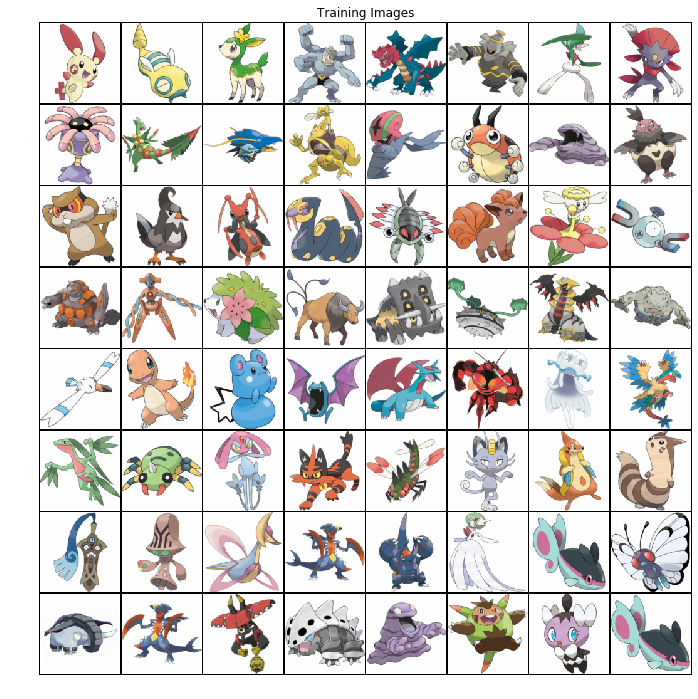

In [8]:
# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(12,12))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [8]:
class _ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, padding=1, bias=False):
        super(_ResidualBlock, self).__init__()
        self.conv_1 = nn.Conv2d(in_channels, out_channels,
                      kernel_size=kernel_size, stride=stride, padding=padding, bias=bias)
        self.bn_1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.PReLU()
        self.conv_2 = nn.Conv2d(out_channels, out_channels,
                      kernel_size=kernel_size, stride=stride, padding=padding, bias=bias)
        self.bn_2 = nn.BatchNorm2d(out_channels)

    def forward(self, tensor):
        r_tensor = tensor
        output = self.conv_1(tensor)
        output = self.bn_1(output)
        output = self.relu(output)
        output = self.conv_2(output)
        output = self.bn_2(output)
        output += r_tensor
        return output


class _SubpixelBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, padding=1, bias=False, upscale_factor=2):
        super(_SubpixelBlock, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels,
                     kernel_size=kernel_size, stride=stride, padding=padding, bias=bias)
        self.pixel_shuffle = nn.PixelShuffle(upscale_factor)
        self.bn = nn.BatchNorm2d(in_channels)
        self.relu = nn.PReLU()

    def forward(self, tensor):
        output = self.conv(tensor)
        output = self.pixel_shuffle(output)
        output = self.bn(output)
        output = self.relu(output)
        return output


class Generator(nn.Module):
    def __init__(self, tag=27):
        super(Generator, self).__init__()
        in_channels = nz + tag
        self.dense_1 = nn.Linear(in_channels, 64*16*16)
        self.bn_1 = nn.BatchNorm2d(64)
        self.relu_1 = nn.PReLU()
        self.residual_layer = self.make_residual_layer(16) # outn=64
        self.bn_2 = nn.BatchNorm2d(64)
        self.relu_2 = nn.PReLU()
        self.subpixel_layer = self.make_subpixel_layer(3) # outn=64
        self.conv_1 = nn.Conv2d(64, 3, kernel_size=9, stride=1, padding=4, bias=True)
        self.tanh_1 = nn.Tanh()

    def forward(self, tensor):
        output = self.dense_1(tensor)
        output = output.view(-1, 64, 16, 16)
        output = self.bn_1(output)
        output = self.relu_1(output)
        r_output = output
        output = self.residual_layer(output)
        output = self.bn_2(output)
        output = self.relu_2(output)
        output += r_output
        output = self.subpixel_layer(output)
        output = self.conv_1(output)
        output = self.tanh_1(output)
        return output

    def make_residual_layer(self, block_size=16):
        layers = []
        for _ in range(block_size):
            layers.append(_ResidualBlock(64, 64, 3, 1))
        return nn.Sequential(*layers)

    def make_subpixel_layer(self, block_size=3):
        layers = []
        for _ in range(block_size):
            layers.append(_SubpixelBlock(64, 256, 3, 1))
        return nn.Sequential(*layers)

In [9]:
class _ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, stride, padding=1, bias=True):
        super(_ResidualBlock, self).__init__()
        self.conv_1 = nn.Conv2d(in_channels, out_channels,
                      kernel_size=kernel_size, stride=stride, padding=padding, bias=bias)
        self.leaky_relu_1 = nn.LeakyReLU()
        self.conv_2 = nn.Conv2d(out_channels, out_channels,
                      kernel_size=kernel_size, stride=stride, padding=padding, bias=bias)
        self.leaky_relu_2 = nn.LeakyReLU()

    def forward(self, tensor):
        r_tensor = tensor
        output = self.conv_1(tensor)
        output = self.leaky_relu_1(output)
        output = self.conv_2(output)
        output += r_tensor
        output = self.leaky_relu_2(output)
        return output


class _Block(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=True, conv_stride=2, conv_kernel_size=4):
        super(_Block, self).__init__()
        self.conv_1 = nn.Conv2d(in_channels, out_channels,
                        kernel_size=conv_kernel_size, stride=conv_stride, padding=padding, bias=bias)
        self.leaky_relu_1 = nn.LeakyReLU()
        self.residual_block_1 = _ResidualBlock(out_channels, out_channels, kernel_size, stride)
        self.residual_block_2 = _ResidualBlock(out_channels, out_channels, kernel_size, stride)

    def forward(self, tensor):
        output = self.conv_1(tensor)
        output = self.leaky_relu_1(output)
        output = self.residual_block_1(output)
        output = self.residual_block_2(output)
        return output


class Discriminator(nn.Module):
    def __init__(self, tag=27):
        super(Discriminator, self).__init__()
        self.reduce_block_1 = _Block(3, 32, conv_kernel_size=4)
        self.reduce_block_2 = _Block(32, 64, conv_kernel_size=4)
        self.reduce_block_3 = _Block(64, 128, conv_kernel_size=4)
        self.reduce_block_4 = _Block(128, 256, conv_kernel_size=3)
        self.reduce_block_5 = _Block(256, 512, conv_kernel_size=3)
        self.conv_1 = nn.Conv2d(512, 1024, kernel_size=3, stride=2, padding=1, bias=True)
        self.leaky_relu_1 = nn.LeakyReLU()
        self.dense_1 = nn.Linear(2*2*1024, 1)
        self.dense_tag = nn.Linear(2*2*1024, tag)
        self.sigmoid = nn.Sigmoid()

    def forward(self, tensor):
        output = self.reduce_block_1(tensor)
        output = self.reduce_block_2(output)
        output = self.reduce_block_3(output)
        output = self.reduce_block_4(output)
        output = self.reduce_block_5(output)
        output = self.conv_1(output)
        output = self.leaky_relu_1(output)
        output = output.view(output.size(0), -1)
        output1 = self.dense_1(output)
        output1 = self.sigmoid(output1)
        output2 = self.dense_tag(output)
        output2 = self.sigmoid(output2)
        return output1, output2

In [10]:
n_types = len(types)
assert n_types == 19

def fake_attr():
    
    type_one_hot = np.zeros(n_types)
    tp1 = random.randint(0, n_types-1)
    tp2 = random.randint(0, 1)
    if tp2 == 1:
        tp2 = random.randint(0, n_types-1)
    else:
        tp2 = -1
    
    type_one_hot[tp1] = 1
    if tp2 != -1:
        type_one_hot[tp2] = 1
    
    gen_one_hot = np.zeros(7)
    gen_id = random.randint(0, 6)
    gen_one_hot[gen_id] = 1
    
    lgn = random.randint(0, 1)
    
    attr = np.hstack([type_one_hot, gen_one_hot, lgn])
    attr = Variable(torch.FloatTensor(attr)).view(1,-1)
    
    return attr


def fake_generator(batch_size, noise_size, device):
    noise = Variable(torch.FloatTensor(batch_size, noise_size)).to(device)
    noise.data.normal_(.0, 1)
    tag = torch.cat([fake_attr() for i in range(batch_size)], dim=0)
    tag = Variable(tag).to(device)
    return noise, tag

def read_newest_model(model_dump_path):
    for rt, dirs, files in os.walk(model_dump_path):
        return files

# SRGAN training class

In [13]:
def initital_network_weights(element):
    if hasattr(element, 'weight'):
        element.weight.data.normal_(.0, .02)


def adjust_learning_rate(optimizer, iteration):
    lr = learning_rate * (0.1 ** (iteration // lr_update_cycle))
    return lr


class SRGAN():
    def __init__(self, input_data_loader):
        #Set Data Loader
        self.data_loader = input_data_loader
        
        #load checkpoint
        checkpoint, checkpoint_name = self.load_checkpoint(model_dump_path)
        if checkpoint == None:
            
            # Don't have pre-trained model. Ignore loading model process.
            # Set Generator and Discriminator
            self.G = Generator().to(device)
            self.D = Discriminator().to(device)
            
            # Initialize Weights
            self.G.apply(initital_network_weights).to(device)
            self.D.apply(initital_network_weights).to(device)
            
            # Set Optimizers
            self.optimizer_G = torch.optim.Adam(self.G.parameters(), lr=learning_rate, betas=(beta_1, 0.999))
            self.optimizer_D = torch.optim.Adam(self.D.parameters(), lr=learning_rate, betas=(beta_1, 0.999))
            self.epoch = 0
            
            self.G_losses = []
            self.D_losses = []
            self.img_list = []
            
        else:
            # Load Generator and Discriminator
            self.G = Generator().to(device)
            self.D = Discriminator().to(device)
          
            #Load Pre-Trained Weights From Checkpoint'
            self.G.load_state_dict(checkpoint['G'])
            self.D.load_state_dict(checkpoint['D'])
            
            #Load Optimizers
            self.optimizer_G = torch.optim.Adam(self.G.parameters(), lr=learning_rate, betas=(beta_1, 0.999))
            self.optimizer_D = torch.optim.Adam(self.D.parameters(), lr=learning_rate, betas=(beta_1, 0.999))
            self.optimizer_G.load_state_dict(checkpoint['optimizer_G'])
            self.optimizer_D.load_state_dict(checkpoint['optimizer_D'])
            self.epoch = checkpoint['epoch']
            
            if os.path.exists('param/srgan_losses.pkl'):
                with open('param/c_srgan_losses.pkl', 'rb') as f1:
                    self.G_losses, self.D_losses = pickle.load(f1)

            if os.path.exists('param/srgan_process_imgs.pkl'):
                with open('param/c_srgan_process_imgs.pkl', 'rb') as f2:
                    self.img_list = pickle.load(f2)
            
        #Set Criterion
        self.label_criterion = nn.BCEWithLogitsLoss().to(device)
        self.tag_criterion = nn.MultiLabelSoftMarginLoss().to(device)


    def load_checkpoint(self, model_dir):
        models_path = read_newest_model(model_dir)
        if len(models_path) == 0:
            return None, None
        models_path.sort()
        new_model_path = os.path.join(model_dump_path, models_path[-1])
        if torch.cuda.is_available():
            checkpoint = torch.load(new_model_path)
        else:
            checkpoint = torch.load(new_model_path, map_location='cuda' if torch.cuda.is_available() else 'cpu')
        return checkpoint, new_model_path


    def train(self, fixed_feat):
        iteration = -1
        #label = Variable(torch.FloatTensor(batch_size, 1.0)).to(device)
        print('Current epoch: {}. Max epoch: {}.'.format(self.epoch, max_epoch))
        
        while self.epoch <= max_epoch:
            msg = {}
        
            adjust_learning_rate(self.optimizer_G, iteration)
            adjust_learning_rate(self.optimizer_D, iteration)
            
            #load tag and image
            
            for i, (avatar_img, avatar_tag) in enumerate(self.data_loader):
                #print(avatar_tag.dtype)
                avatar_img = Variable(avatar_img).to(device)
                avatar_tag = Variable(torch.FloatTensor(avatar_tag.float())).to(device)
            
                iteration += 1
                
                # D : G = 2 : 1
                # 1. Training D
                # 1.1. use real image for discriminating
                self.D.zero_grad()
                img_batch = avatar_img.to(device)
                
                label_p, tag_p = self.D(avatar_img)
                
                # Format batch
                b_size = img_batch.size(0)
                label = torch.full((b_size, 1), real_label, device=device)
                avatar_img = img_batch
                
                # 1.2. real image's loss
                real_label_loss = self.label_criterion(label_p, label)
                real_tag_loss = self.tag_criterion(tag_p, avatar_tag)
                real_loss_sum = real_label_loss * lambda_adv / 2.0 + real_tag_loss * lambda_adv / 2.0
                real_loss_sum.backward()
                
                D_x = label_p.mean().item()

                # 1.3. use fake image for discriminating
                g_noise, fake_tag = fake_generator(b_size, nz, device)
                
                fake_feat = torch.cat([g_noise, fake_tag], dim=1)
                
                fake_img = self.G(fake_feat).detach()
                fake_label_p, fake_tag_p = self.D(fake_img)
                label = torch.full((b_size, 1), fake_label, device=device)

                # 1.4. fake image's loss
                fake_label_loss = self.label_criterion(fake_label_p, label)
                fake_tag_loss = self.tag_criterion(fake_tag_p, fake_tag)
                fake_loss_sum = fake_label_loss * lambda_adv / 2.0 + fake_tag_loss * lambda_adv / 2.0
                fake_loss_sum.backward()
                
                errD = fake_loss_sum + real_loss_sum
                D_G_z1 = fake_label_p.mean().item()

                # 1.5. gradient penalty
                # https://github.com/jfsantos/dragan-pytorch/blob/master/dragan.py
                alpha_size = [1] * avatar_img.dim()
                alpha_size[0] = avatar_img.size(0)
                alpha = torch.rand(alpha_size).to(device)
                x_hat = Variable(alpha * avatar_img.data + (1 - alpha) * \
                                 (avatar_img.data + 0.5 * avatar_img.data.std() * Variable(torch.rand(avatar_img.size())).to(device)),
                                 requires_grad=True).to(device)
                
                pred_hat, pred_tag = self.D(x_hat)
                gradients = grad(outputs=pred_hat, inputs=x_hat, grad_outputs=torch.ones(pred_hat.size()).to(device),
                                 create_graph=True, retain_graph=True, only_inputs=True)[0].view(x_hat.size(0), -1)
                gradient_penalty = lambda_gp * ((gradients.norm(2, dim=1) - 1) ** 2).mean()
                gradient_penalty.backward()
    

                # 1.6. update optimizer
                self.optimizer_D.step()

                # 2. Training G
                # 2.1. generate fake image
                self.G.zero_grad()
                
                g_noise, fake_tag = fake_generator(b_size, nz, device)
                fake_feat = torch.cat([g_noise, fake_tag], dim=1)
                fake_img = self.G(fake_feat)
                
                fake_label_p, fake_tag_p = self.D(fake_img)
                label = torch.full((b_size, 1), real_label, device=device)

                # 2.2. calc loss
                label_loss_g = self.label_criterion(fake_label_p, label)
                tag_loss_g = self.tag_criterion(fake_tag_p, fake_tag)
                loss_g = label_loss_g  * lambda_adv / 2.0 + tag_loss_g * lambda_adv / 2.0
                loss_g.backward()
                D_G_z2 = fake_label_p.mean().item()
                
                # 2.2. update optimizer
                self.optimizer_G.step()

                # save intermediate file
                if iteration % verbose_T == 0:
                    vutils.save_image(avatar_img.data.view(b_size, 3, avatar_img.size(2), avatar_img.size(3)),
                                    os.path.join(gen_img_path, 'real_image_{}.png'.format(str(iteration).zfill(8))))
                    
                    g_noise, fake_tag = fake_generator(b_size, nz, device)
                    fake_feat = torch.cat([g_noise, fake_tag], dim=1)
                    fake_img = self.G(fake_feat)
                    vutils.save_image(fake_img.data.view(b_size, 3, avatar_img.size(2), avatar_img.size(3)),
                                    os.path.join(gen_img_path, 'fake_image_{}.png'.format(str(iteration).zfill(8))))
                    print('Saved intermediate file in {}'.format(os.path.join(gen_img_path, 'fake_image_{}.png'.format(str(iteration).zfill(8)))))
                
                if i % 100 == 0:
                    print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                          % (self.epoch + 1, max_epoch, (i+1), len(self.data_loader),
                             errD.item(), loss_g.item(), D_x, D_G_z1, D_G_z2))
                
                if iteration % 10 == 0:
                    # Save Losses for plotting later
                    self.G_losses.append(loss_g.item())
                    self.D_losses.append(errD.item())

                # Check how the generator is doing by saving G's output on fixed_noise
                if (iteration % 500 == 0) or ((self.epoch == max_epoch-1) and (i == len(self.data_loader)-1)):
                    with torch.no_grad():
                        fake = self.G(fixed_feat).detach().cpu()
                    self.img_list.append(vutils.make_grid(fake, padding=2, normalize=True))


            # dump checkpoint
            torch.save({
                'epoch': self.epoch,
                'D': self.D.state_dict(),
                'G': self.G.state_dict(),
                'optimizer_D': self.optimizer_D.state_dict(),
                'optimizer_G': self.optimizer_G.state_dict(),
            }, '{}/checkpoint_{}.tar'.format(model_dump_path, str(self.epoch).zfill(4)))
            print('Checkpoint saved in: {}'.format('{}/checkpoint_{}.tar'.format(model_dump_path, str(self.epoch).zfill(4))))
            
            # Saving losses:
            with open('param/c_srgan_losses.pkl', 'wb') as f1:
                pickle.dump([self.G_losses, self.D_losses], f1)

            # Saving images:
            with open('param/c_srgan_process_imgs.pkl', 'wb') as f2:  
                pickle.dump(self.img_list, f2)
                
                
            self.epoch += 1
        return self.img_list, self.G_losses, self.D_losses



In [14]:
if __name__ == '__main__':
    if not os.path.exists(model_dump_path):
        os.mkdir(model_dump_path)
    if not os.path.exists(gen_img_path):
        os.mkdir(gen_img_path)
        
    img_list = []
    G_losses = []
    D_losses = []

    g_noise, fake_tag = fake_generator(64, nz, device)
    fixed_feat = torch.cat([g_noise, fake_tag], dim=1)
    
    gan = SRGAN(dataloader)
    img_list, G_losses, D_losses = gan.train(fixed_feat)

Current epoch: 40. Max epoch: 50.
Saved intermediate file in c_gen_images/fake_image_00000000.png
[41/50][1/204]	Loss_D: 47.1340	Loss_G: 23.5670	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
[41/50][101/204]	Loss_D: 47.1340	Loss_G: 23.5670	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
[41/50][201/204]	Loss_D: 47.1340	Loss_G: 23.5670	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
Checkpoint saved in: condition_model_checkpoints//checkpoint_0040.tar
[42/50][1/204]	Loss_D: 47.1340	Loss_G: 23.5670	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
[42/50][101/204]	Loss_D: 47.1340	Loss_G: 23.5670	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
[42/50][201/204]	Loss_D: 47.1340	Loss_G: 23.5670	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
Checkpoint saved in: condition_model_checkpoints//checkpoint_0041.tar
[43/50][1/204]	Loss_D: 47.1340	Loss_G: 23.5670	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
Saved intermediate file in c_gen_images/fake_image_00000500.png
[43/50][101/204]	Loss_D: 47.1340	Loss_G: 23.5670	D(x): 0.0000	D(G(z)): 0.0000 / 0.0000
[43/50][

In [11]:
img_list = gan.img_list
G_losses = gan.G_losses
D_losses = gan.D_losses

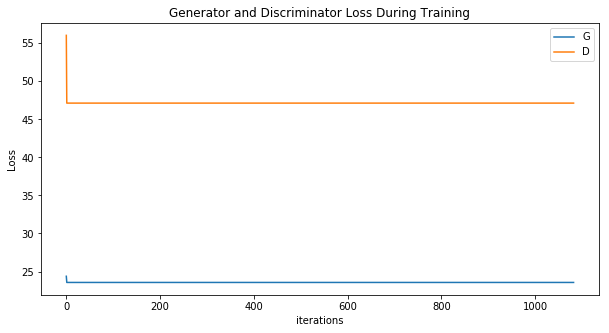

In [15]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21879016 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


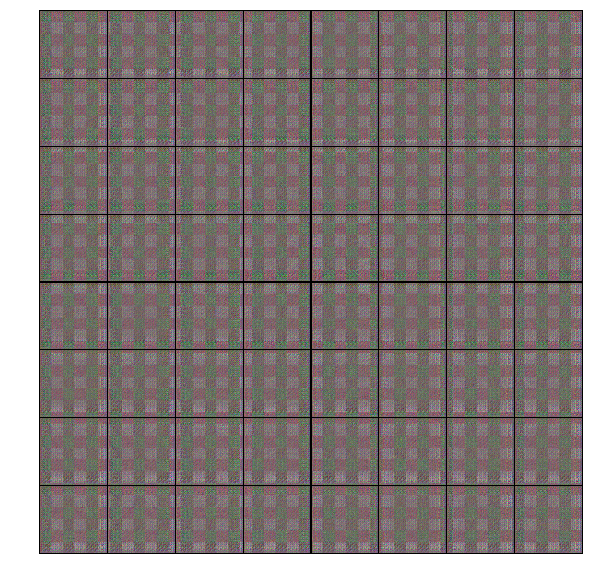

In [16]:
#%%capture
fig = plt.figure(figsize=(10,10))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

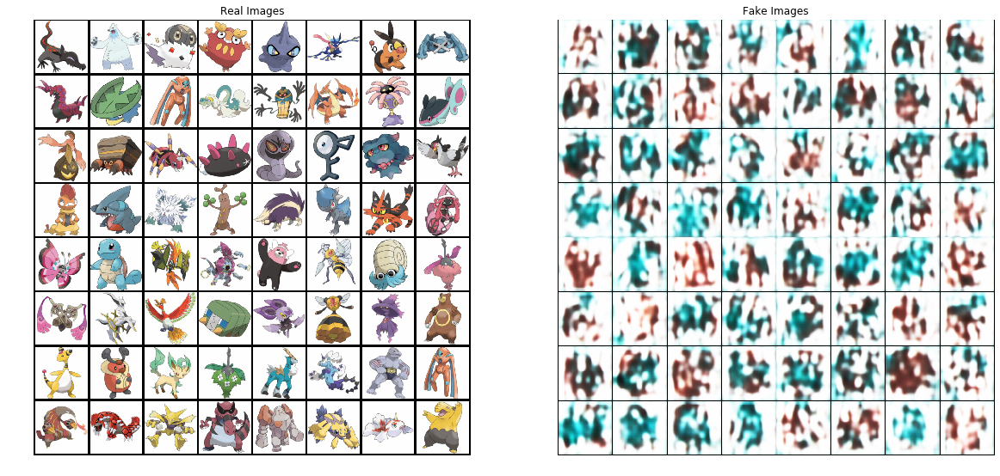

In [19]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(25,25))
plt.subplot(2,1,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(2,1,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()